# VIRAT Video Dataset
## Data Wrangling & EDA

### Data Sources

VIRAT dataset metadata: 
- https://viratdata.org/ </br>

VIRAT dataset:
- https://data.kitware.com/#collection/56f56db28d777f753209ba9f/folder/56f57e748d777f753209bed7
    - ~40GB, including annotations
    - Uploaded to my local machine

IARPA DIVA annotations:
- https://gitlab.kitware.com/viratdata/viratannotations
    - additional (better?) annotation files, added later in 2020

MEVA dataset*:
- https://mevadata.org/resources/README-meva-kf1-data.html
    - ~470GB
    - Available in an AWS S3 Bucket
        - *Currently not used by me

### In This Notebook:

1. Problem Statement
- 1.1 -- Project Description & Outline
2. Data Ingestion
- 2.1 -- VIRAT Video Dataset
3. Data Exploration
- 3.1 -- VIRAT Ground Video Files
- 3.2 -- Annotation Files EDA
- 3.3 -- Data Cleaning
4. IARPA DIVA Annotations
- 4.1 -- DIVA Annotation Files EDA
- 4.2 -- Data Formats
    - .types.yml
    - .geom.yml
    - .regions.yml
    - .activities.yml
- 4.3 -- Object Detection Verification
- 4.4 -- Object Track Verification
- 4.5 -- Event Detection Verification
- 4.6 -- Metrics

In [7]:
import os
import pandas as pd
import numpy as np
import cv2
import time
import random
import yaml

## 1. Problem Statement
Video surveillance could be made better by automated monitoring. While Object Detection Techniques are robust, Activity and Event Detection techniques lag behind. The purpose of this project is to research and develop a Computer Vision Pipeline which takes in video surveillance data and returns metrics on activities performed within the video (i.e. Entering Vehicle, Theft, Leaving Package Unattended, etc.).

#### 1.1 -- Project Description
Use the VIRAT Video Dataset to research and develop Event Detection techniques.

Background on VIRAT Video Dataset:

- The VIRAT Video Dataset collection work (version 2.0 released in 2011) is supported by Defense Advanced Research Projects Agency (DARPA) under Contract No. HR0011-08-C-0135 - https://viratdata.org/

- DIVA is a Research Program (begun in 2017) of the Intelligence Advanced Research Projects Agency (IARPA) which seeks to "create automatic activity detectors that can watch hours of video and highlight the few seconds when a person or vehicle does a specific activity"

    - "DIVA is a four-year program that began in September 2017 to develop activity detection capabilities that will have a significant impact on security video monitoring workflow by providing automated alerts, enabling a single operator to monitor a multi-camera network for user-defined threat activities or other activities of interest. DIVA will facilitate forensic analysis as well. To date, DIVA has built detectors for specific defined activities that surpass human detection capabilities, detecting more than twice as many activity instances as were found by a human control group consisting of crowdsourced labor. The ultimate objective is to detect 75 percent of activities while raising a false alarm only two percent of the time." - https://www.iarpa.gov/research-programs/diva
        

## 2. Data Ingestion

#### 2 -- VIRAT Video dataset:
- https://data.kitware.com/#collection/56f56db28d777f753209ba9f/folder/56f57e748d777f753209bed7
    - ~40GB, including annotations
    - Uploaded to my local machine


In [24]:
# view video files on my local
vid_dir = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original'
vid = os.listdir(vid_dir)
vid.sort()
vid[:4]

['VIRAT_S_000001.mp4',
 'VIRAT_S_000002.mp4',
 'VIRAT_S_000003.mp4',
 'VIRAT_S_000004.mp4']

In [25]:
# view annotation files on my local
ann_dir = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations'
ann = os.listdir(ann_dir)
ann.sort()
ann[:12]

['VIRAT_S_000001.viratdata.events.txt',
 'VIRAT_S_000001.viratdata.mapping.txt',
 'VIRAT_S_000001.viratdata.objects.txt',
 'VIRAT_S_000002.viratdata.events.txt',
 'VIRAT_S_000002.viratdata.mapping.txt',
 'VIRAT_S_000002.viratdata.objects.txt',
 'VIRAT_S_000003.viratdata.events.txt',
 'VIRAT_S_000003.viratdata.mapping.txt',
 'VIRAT_S_000003.viratdata.objects.txt',
 'VIRAT_S_000004.viratdata.events.txt',
 'VIRAT_S_000004.viratdata.mapping.txt',
 'VIRAT_S_000004.viratdata.objects.txt']

# 3. Data Exploration

In [33]:
# function to view video
def view_video(video_path):
    print("press 'q' to quit...")
    # open Video Capture object
    cap = cv2.VideoCapture(video_path)
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        # Display the frame
        cv2.imshow(f'{vid[idx]}', frame)
        # Press 'q' to exit the loop
        if cv2.waitKey(1) & 0xFF == ord('q'):
            end_sequence(cap)
            break
    # end
    end_sequence(cap)

In [32]:
# function to end
def end_sequence(cap):
    # Release Video Capture
    cap.release()

    # Close cv2 window
    cv2.destroyAllWindows()
    cv2.waitKey(1)
    cv2.waitKey(1)
    cv2.waitKey(1)
    cv2.waitKey(1); # mac needs 4 loops of .waitKey(1) to to destroy windows..

#### 3.1 -- VIRAT Ground Video Files

In [35]:
idx = 14 # change idx to change video

video_path = vid_dir + '/' + vid[idx]  # get path

In [36]:
view_video(video_path) # play video

press 'q' to quit...


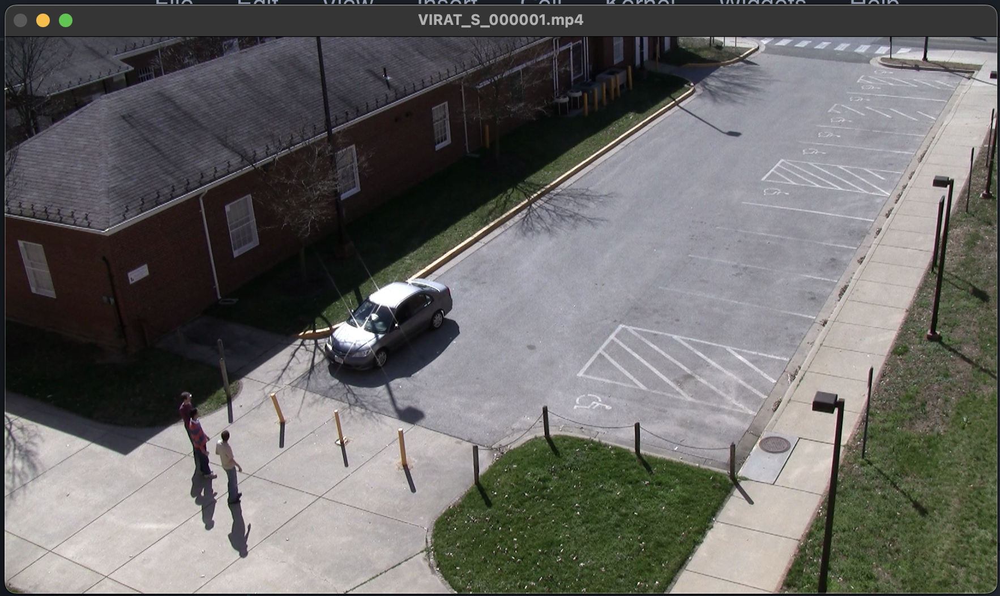

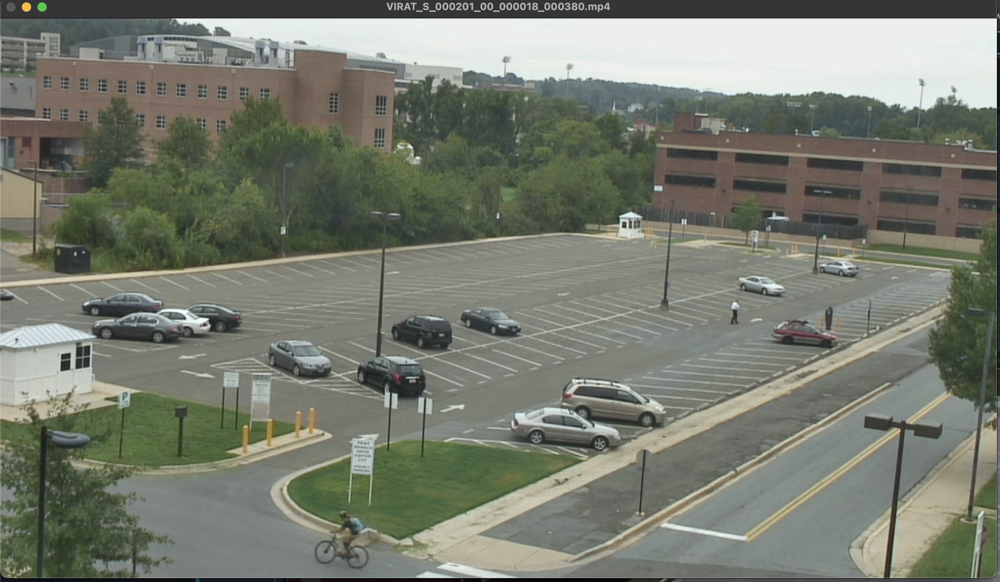

#### 3.2 -- Annotation Files EDA

#### Object Files
Most basic data structure is our Objects. Let's begin with __Object Files__

From Documentation:

#### Object file format

Files are named as '%s.viratdata.objects.txt'
Each line captures informabiont about a bounding box of an object (person/car etc) at the corresponding frame.
Each object track is assigned a unique 'object id' identifier. 
Note that:
- an object may be moving or static (e.g., parked car).
- an object track may be fragmented into multiple tracks.

Object File Columns
1. Object id        (a unique identifier of an object track. Unique within a file.)
2. Object duration  (duration of the object track)
3. Current frame    (corresponding frame number)
4. bbox lefttop x   (horizontal x coordinate of the left top of bbox, origin is lefttop of the frame)
5. bbox lefttop y   (vertical y coordinate of the left top of bbox, origin is lefttop of the frame)
6. bbox width       (horizontal width of the bbox)
7. bbox height      (vertical height of the bbox)
8. Objct Type       (object type)

Object Type ID (for column 8 above for object files)
1. person
2. car              (usually passenger vehicles such as sedan, truck)
3. vehicles         (vehicles other than usual passenger cars. Examples include construction vehicles)
4. object           (neither car or person, usually carried objects)
5. bike, bicylces   (may include engine-powered auto-bikes)

In [60]:
object_columns = ['Object_ID', 'Duration', 'Current_Frame', 'bbox_lefttop_x',
                  'bbox_lefttop_y', 'bbox_width', 'bbox_height', 'Object_Type']
objects = []
for i in range(len(ann)):
    if ann[i][-11:] == 'objects.txt':
        objects.append(ann[i])

In [61]:
idx = 0 # change idx to change objects.txt file

object_path = ann_dir + '/' + objects[idx]  # get path

In [63]:
object_df = pd.read_csv(object_path, sep=" ", names=object_columns, index_col=False)
object_df.head()

,Object_ID,Duration,Current_Frame,bbox_lefttop_x,bbox_lefttop_y,bbox_width,bbox_height,Object_Type
0,1,385,3455,1,663,76,132,1
1,1,385,3456,1,663,76,132,1
2,1,385,3457,1,663,76,132,1
3,1,385,3458,1,663,76,132,1
4,1,385,3459,1,663,76,132,1


#### Playback Video with Boxes

In [69]:
# function to draw bounding boxes
def draw_bounding_boxes(frame, boxes, color=(0, 255, 0), thickness=2):
    for box in boxes:
        x_min, y_min, x_max, y_max = box
        cv2.rectangle(frame, (x_min, y_min), (x_max, y_max), color, thickness)
    return frame

In [73]:
# function to play video with bounding boxes
def playback_with_boxes(path, data):
    print("Press 'q' to quit playback")
    # preprocess data
    df_boxes = data.drop(['Object_ID', 'Duration', 'Object_Type'], axis=1)
    df_boxes['bbox_width'] = df_boxes['bbox_lefttop_x'] + df_boxes['bbox_width']
    df_boxes['bbox_height'] = df_boxes['bbox_lefttop_y'] + df_boxes['bbox_height']
    col_names = {'Current_Frame':'frame', 'bbox_lefttop_x':'x_min', 'bbox_width':'x_max', 
                 'bbox_lefttop_y':'y_min', 'bbox_height':'y_max'}
    df_boxes.rename(columns=col_names, inplace=True)
    # open Video Capture object
    cap = cv2.VideoCapture(path)
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        # get current frame, draw bounding boxes on it
        frame_number = int(cap.get(cv2.CAP_PROP_POS_FRAMES))
        frame_boxes = df_boxes[df_boxes['frame'] == frame_number][['x_min', 'y_min', 'x_max', 'y_max']].values
        frame_with_boxes = draw_bounding_boxes(frame, frame_boxes)
        # Display the frame
        cv2.imshow(f'{vid[idx]}', frame_with_boxes)
        # Press 'q' to exit the loop
        if cv2.waitKey(1) & 0xFF == ord('q'):
            end_sequence(cap)
            break
    # end
    end_sequence(cap)

In [71]:
idx = 0 # change idx to change video and objects.txt files

video_path = vid_dir + '/' + vid[idx]  # get path
object_path = ann_dir + '/' + objects[idx]  # get path
assert (video_path.split('/')[-1][:7] == object_path.split('/')[-1][:7]) # ensure files match
object_df = pd.read_csv(object_path, sep=" ", names=object_columns, index_col=False) # get data

In [72]:
playback_with_boxes(video_path, object_df)

Press 'q' to quit playback


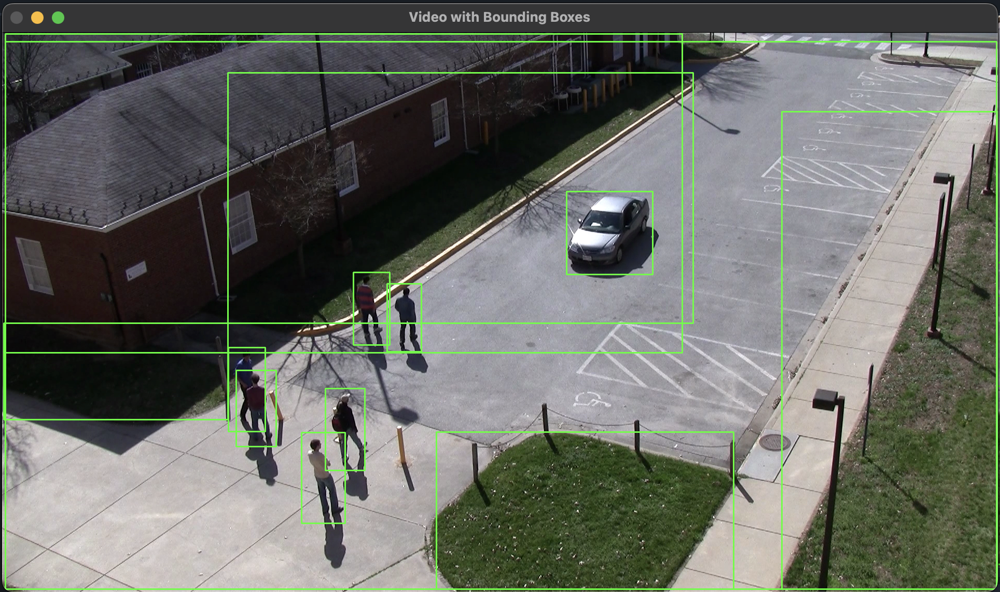

Correct boxes are present for people, but erroneous boxes exist

In [78]:
object_df.sort_values(by=['Current_Frame'])[:14]

,Object_ID,Duration,Current_Frame,bbox_lefttop_x,bbox_lefttop_y,bbox_width,bbox_height,Object_Type
385,3,4732,0,613,469,254,189,2
199326,31,20656,0,435,78,897,483,0
158124,29,20656,0,1503,153,416,921,0
96156,26,20656,0,6,3,1305,615,0
137468,28,20656,0,837,771,573,303,0
116812,27,20656,0,3,561,432,186,0
199327,31,20656,1,435,78,897,483,0
386,3,4732,1,612,468,255,190,2
158125,29,20656,1,1503,153,416,921,0
116813,27,20656,1,3,561,432,186,0


Note Objects with Duration 20565 (full length of video). It appears that Object_Type == 0 consist of the clutter on-screen.

### 3.3 Data Cleaning

#### View specific object
- Type 0 objects appear to be clutter.

In [81]:
# Function to display image (frame in middle of 'Duration')
# with bounding box of specific object
def display_this_object(obj, df, video_path, color=(0, 255, 0), thickness=2):
    """takes Object_ID, video path and full object dataframe,
    displays a single image with bounding box
    from first appearance of object in video"""
    
    # Get index of the middle frame of this object
    start_idx = pd.DataFrame(df[df['Object_ID'] == obj].iloc[0]).T.index.values[0]
    half_dur = pd.DataFrame(df[df['Object_ID'] == obj].iloc[0]).T['Duration'].values[0] * 0.5
    idx = int(half_dur + start_idx)
    # ALT:
    # uncomment for first frame
    ###idx = pd.DataFrame(df[df['Object_ID'] == obj].iloc[0]).T.index.values[0]
    
    # Get Bounding Box coordinates
    x_min = df['bbox_lefttop_x'][idx]
    y_min = df['bbox_lefttop_y'][idx]
    x_max = df['bbox_lefttop_x'][idx] + df['bbox_width'][idx]
    y_max = df['bbox_lefttop_y'][idx] + df['bbox_height'][idx]
    
    # Load the video
    cap = cv2.VideoCapture(video_path)

    # set frame position
    frame_index = df.iloc[idx]['Current_Frame']
    cap.set(cv2.CAP_PROP_POS_FRAMES, frame_index)

    # Read the Frame
    ret, frame = cap.read()
    if not ret:
        print("Failed to read the frame")
        return
    if ret:
        # Draw bounding box on the frame
        cv2.rectangle(frame, (x_min, y_min), (x_max, y_max), color, thickness)

        # Display the frame
        print("Object_ID: ", obj)
        print("Current_Frame: ", frame_index)
        cv2.imwrite("frame%i.jpg"%frame_index, frame)
        image = cv2.imread("frame%i.jpg"%frame_index)
        cv2.imshow("Object {} -- Frame {}".format(obj, frame_index), image)

        cv2.waitKey(5000) # wait 5 seconds

        # Delete the image
        if os.path.exists("frame%i.jpg"%frame_index):
            os.remove("frame%i.jpg"%frame_index)

        end_sequence(cap) # Terminate all windows

        return

In [82]:
video_path

'/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/VIRAT_S_000001.mp4'

In [85]:
# for first video, objects 26 - 31 were of Type 0
object_id = 31

display_this_object(object_id, object_df, video_path)

Object_ID:  31
Current_Frame:  10328


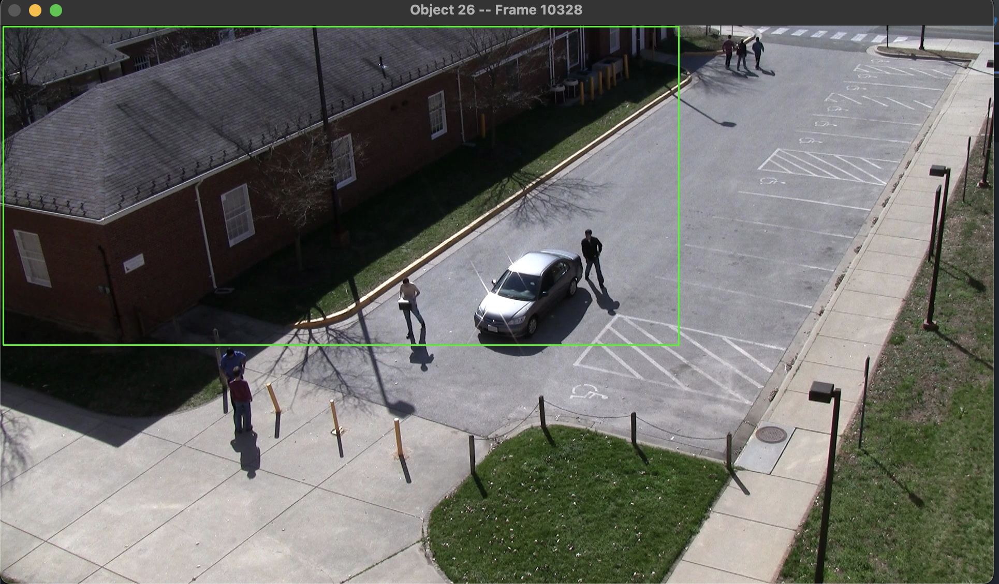

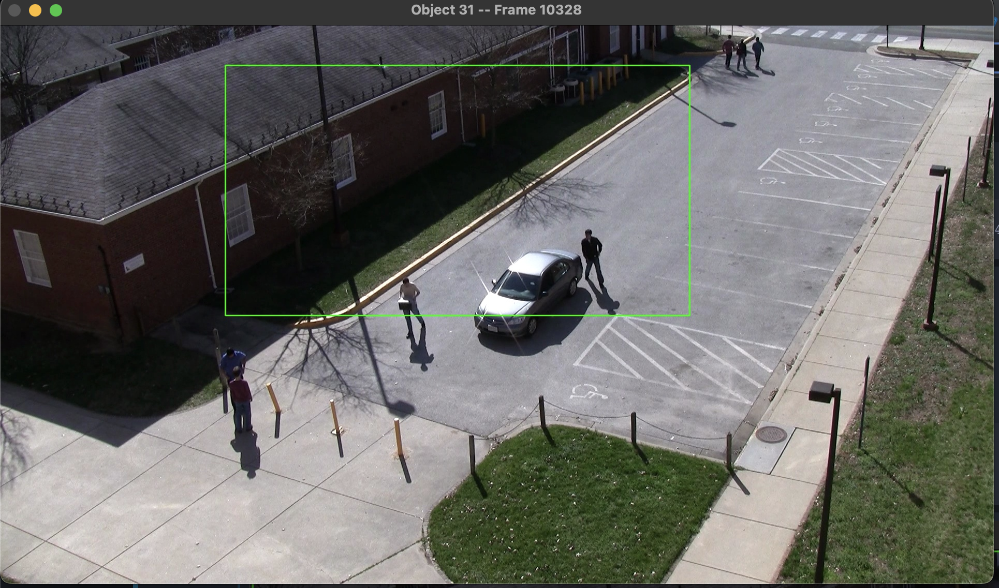

#### What are Type-0 objects in other scenes?

#### Getting all file names in lists

In [86]:
# get all video paths
all_video_paths = os.listdir('/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original')
all_video_paths.sort()
print(all_video_paths[:10])

['VIRAT_S_000001.mp4', 'VIRAT_S_000002.mp4', 'VIRAT_S_000003.mp4', 'VIRAT_S_000004.mp4', 'VIRAT_S_000006.mp4', 'VIRAT_S_000101.mp4', 'VIRAT_S_000102.mp4', 'VIRAT_S_000200_00_000100_000171.mp4', 'VIRAT_S_000200_01_000226_000268.mp4', 'VIRAT_S_000200_02_000479_000635.mp4']


In [87]:
# get all object paths
all_object_paths = []
obj_p = os.listdir('/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations')
for string in obj_p:
    if string[-11:] == 'objects.txt':
        all_object_paths.append(string)
all_object_paths.sort()
print(all_object_paths[:10])

['VIRAT_S_000001.viratdata.objects.txt', 'VIRAT_S_000002.viratdata.objects.txt', 'VIRAT_S_000003.viratdata.objects.txt', 'VIRAT_S_000004.viratdata.objects.txt', 'VIRAT_S_000006.viratdata.objects.txt', 'VIRAT_S_000101.viratdata.objects.txt', 'VIRAT_S_000102.viratdata.objects.txt', 'VIRAT_S_000200_00_000100_000171.viratdata.objects.txt', 'VIRAT_S_000200_01_000226_000268.viratdata.objects.txt', 'VIRAT_S_000200_03_000657_000899.viratdata.objects.txt']


In [88]:
# Q: Why is the index 9 path different???
# A: There is not a 1 to 1 mapping for videos and object annotation files. 
#    i.e. some videos have no matching objects.txt file

In [89]:
len(all_video_paths)

329

In [90]:
len(all_object_paths)

315

In [91]:
# To resolve this,
# let's take the unique identifier string from the video paths and map them
# this way, we know the mapping is correct, 
# and can observe when there is no object file for a video

In [92]:
all_video_paths[0][:14]

'VIRAT_S_000001'

In [93]:
all_video_paths[7][:23]

'VIRAT_S_000200_00_00010'

In [94]:
# Map identifier strings (keys) to video and object filepaths

all_keys = {}
# first 7 videos have shorter identifier sequences
for i in range(7):
    key = all_video_paths[i][:14]
    keyed_video = all_video_paths[i]
    keyed_object = None
    for j in range(0, len(all_object_paths)):
        if all_object_paths[j][:14] == key:
            keyed_object = all_object_paths[j]
    all_keys[key] = [keyed_video, keyed_object]
# rest are longer
for i in range(7, len(all_video_paths)):
    key = all_video_paths[i][:23]
    keyed_video = all_video_paths[i]
    keyed_object = None
    for j in range(0, len(all_object_paths)):
        if all_object_paths[j][:23] == key:
            keyed_object = all_object_paths[j]
    all_keys[key] = [keyed_video, keyed_object]

In [95]:
len(all_keys) # should be same as len(all_video_paths) (329)

329

In [96]:
# for usage, make a list of the keys
key_list = []
for key in all_keys.keys():
    key_list.append(key)

In [97]:
# cool
all_keys[key_list[8]]

['VIRAT_S_000200_01_000226_000268.mp4',
 'VIRAT_S_000200_01_000226_000268.viratdata.objects.txt']

In [98]:
# let's now count the type-0 objects for the first 5 videos:

# establish constants
vid_prefix = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/'
obj_prefix = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/'
object_columns = ['Object_ID', 'Duration', 'Current_Frame', 'bbox_lefttop_x',
                  'bbox_lefttop_y', 'bbox_width', 'bbox_height', 'Object_Type']

for i in range(5):
    # get video and object paths
    video_path = vid_prefix + all_keys[key_list[i]][0]
    object_path = obj_prefix + all_keys[key_list[i]][1]
    # get dataframe from object path
    df_obj = pd.read_csv(object_path, sep=" ", names=object_columns, index_col=False)
    # count unique values of objects with type 0
    type0_objs = df_obj[df_obj['Object_Type'] == 0]['Object_ID'].unique()
    
    # print our results
    print(object_path)
    print(type0_objs)

/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_000001.viratdata.objects.txt
[26 27 28 29 30 31]
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_000002.viratdata.objects.txt
[14 15 16 17 18 19 20 21]
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_000003.viratdata.objects.txt
[15 16 17 18 19 20 21 22 23]
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_000004.viratdata.objects.txt
[]
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_000006.viratdata.objects.txt
[]


There was an error code in processing the data to a pandas DataFrame for line 115562 of the .objects.txt file for VIRAT_S_000002

Let's take a look and see what the issue in the data is:

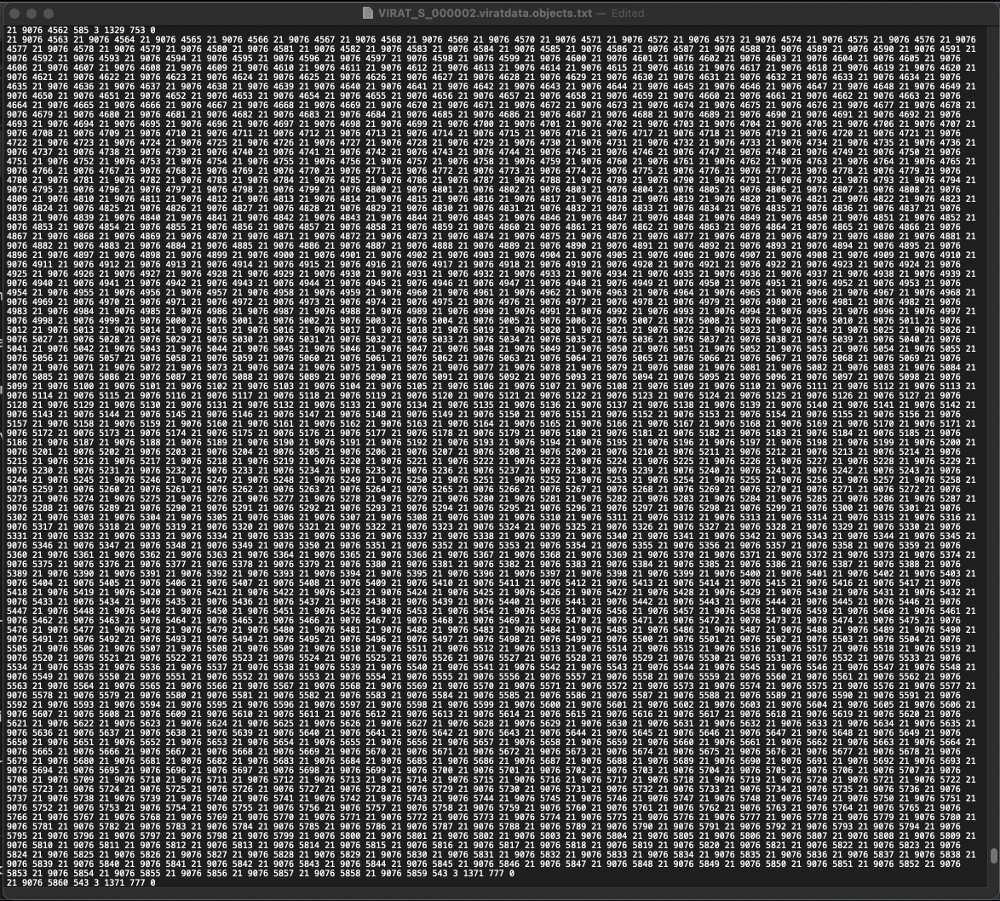

#### Discovered issue: 
Object_ID 21 of this objects.txt file is missing the last 5 columns (bbox coords, and object_id) as well as the 'Enter' key 

#### Resolution:
I'm going to remove these records, since they appear to be corrupted data. Also, the object is of type 0 and is likely to be removed for irrelevance.

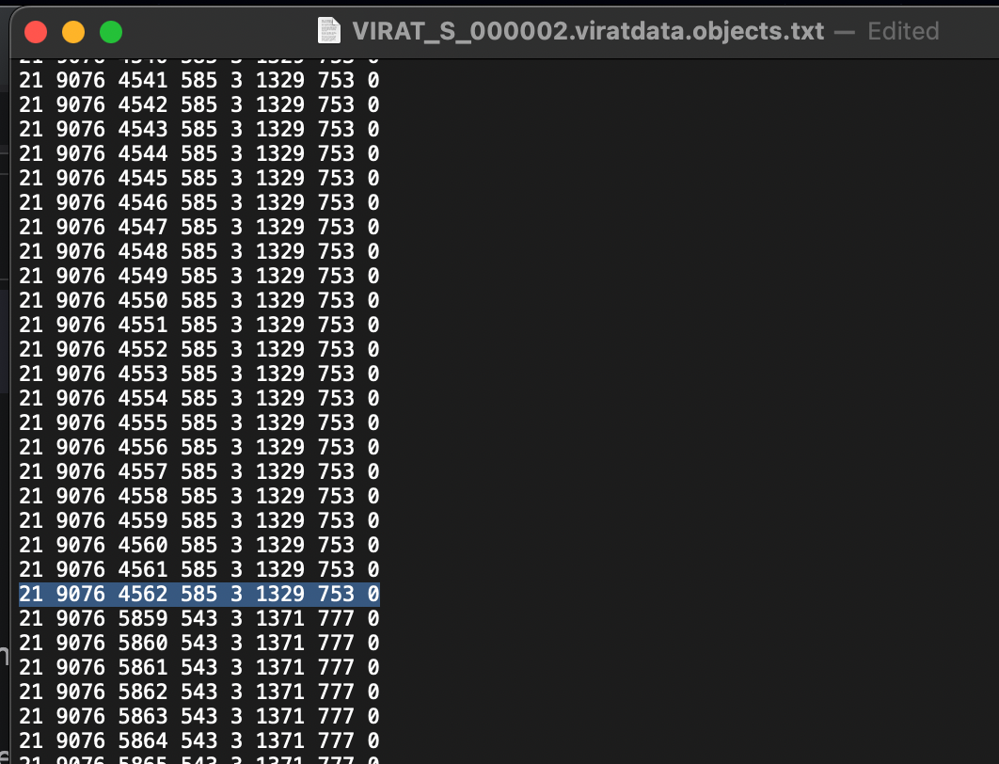

Seems fine

OK, trying again. Let's see how many type-0 objects there are for the first 5 videos:

In [100]:
# displaycount the type-0 objects for the first 5 videos:

# establish constants
vid_prefix = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/'
obj_prefix = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/'
object_columns = ['Object_ID', 'Duration', 'Current_Frame', 'bbox_lefttop_x',
                  'bbox_lefttop_y', 'bbox_width', 'bbox_height', 'Object_Type']

for i in range(5):
    # get video and object paths
    video_path = vid_prefix + all_keys[key_list[i]][0]
    object_path = obj_prefix + all_keys[key_list[i]][1]
    # get dataframe from object path
    df_obj = pd.read_csv(object_path, sep=" ", names=object_columns, index_col=False)
    # count unique values of objects with type 0
    type0_objs = df_obj[df_obj['Object_Type'] == 0]['Object_ID'].unique()
    
    # print our results
    print(video_path)
    print(object_path)
    print(len(type0_objs), " type-0 objects. Object_IDs: \t", type0_objs)

/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/VIRAT_S_000001.mp4
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_000001.viratdata.objects.txt
6  type-0 objects. Object_IDs: 	 [26 27 28 29 30 31]
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/VIRAT_S_000002.mp4
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_000002.viratdata.objects.txt
8  type-0 objects. Object_IDs: 	 [14 15 16 17 18 19 20 21]
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/VIRAT_S_000003.mp4
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_000003.viratdata.objects.txt
9  type-0 objects. Object_IDs: 	 [15 16 17 18 19 20 21 22 23]
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/VIRAT_S_000004.mp4
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_000004.viratdata.objects.txt
0  type-0 objects. Object_IDs: 	 []
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dat

### Ok, now let's see these objects

In [101]:
# Variant to display using first frame instead of middle frame

def display_this_object_ff(obj, df, path=video_path, color=(0, 255, 0), thickness=2):
    """takes Object_ID, video path and full object dataframe,
    displays a single image with bounding box
    from first appearance of object in video"""
    
    # Get index of the middle frame of this object
    ###start_idx = pd.DataFrame(df[df['Object_ID'] == obj].iloc[0]).T.index.values[0]
    ###half_dur = pd.DataFrame(df[df['Object_ID'] == obj].iloc[0]).T['Duration'].values[0] * 0.5
    ###idx = int(half_dur + start_idx)
    # ALT:
    # uncomment for first frame
    idx = pd.DataFrame(df[df['Object_ID'] == obj].iloc[0]).T.index.values[0]
    
    # Get Bounding Box coordinates
    x_min = df['bbox_lefttop_x'][idx]
    y_min = df['bbox_lefttop_y'][idx]
    x_max = df['bbox_lefttop_x'][idx] + df['bbox_width'][idx]
    y_max = df['bbox_lefttop_y'][idx] + df['bbox_height'][idx]
    
    # Load the video
    cap = cv2.VideoCapture(video_path)

    # set the frame position
    frame_index = df.iloc[idx]['Current_Frame']
    cap.set(cv2.CAP_PROP_POS_FRAMES, frame_index)

    # Read the Frame
    ret, frame = cap.read()
    if not ret:
        print("Failed to read the frame")
        return
    if ret:
        # Draw bounding box on the frame
        cv2.rectangle(frame, (x_min, y_min), (x_max, y_max), color, thickness)

        # Display the frame
        print("Object_ID: ", obj)
        print("Current_Frame: ", frame_index)
        cv2.imwrite("frame%i.jpg"%frame_index, frame)
        image = cv2.imread("frame%i.jpg"%frame_index)
        vid_index = all_keys[key_list[i]][0].split('.')[0] # !!!! THIS BREAKS IT IF NOT IN i LOOP
        cv2.imshow("Object {} -- Frame {} -- Video {}".format(obj, frame_index, vid_index), image)

        cv2.waitKey(2000) # wait 2 seconds

        # Delete the image
        if os.path.exists("frame%i.jpg"%frame_index):
            os.remove("frame%i.jpg"%frame_index)

        end_sequence(cap) # Terminate all windows

        return

In [34]:
for i in range(2, 4):
    # get video and object paths
    video_path = vid_prefix + all_keys[key_list[i]][0]
    object_path = obj_prefix + all_keys[key_list[i]][1]
    
    # get dataframe from object path
    df_obj = pd.read_csv(object_path, sep=" ", names=object_columns, index_col=False)
    
    # print where we are
    print(video_path)
    print(object_path)
    
    # view these objects in turn
    type0_objs = df_obj[df_obj['Object_Type'] == 0]['Object_ID'].unique()
    for obj in type0_objs:
        display_this_object_ff(obj, df_obj)
    

/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/VIRAT_S_000003.mp4
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_000003.viratdata.objects.txt
Object_ID:  15
Current_Frame:  0
Object_ID:  16
Current_Frame:  0
Object_ID:  17
Current_Frame:  0
Object_ID:  18
Current_Frame:  0
Object_ID:  19
Current_Frame:  0
Object_ID:  20
Current_Frame:  0
Object_ID:  21
Current_Frame:  0
Object_ID:  22
Current_Frame:  0
Object_ID:  23
Current_Frame:  0
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/VIRAT_S_000004.mp4
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_000004.viratdata.objects.txt


### Let's count the type-0 objects for all videos
- This will also help to determine if there is more corrupted data

In [35]:
# displaycount the type-0 objects for all videos:

# establish constants
vid_prefix = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/'
obj_prefix = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/'
object_columns = ['Object_ID', 'Duration', 'Current_Frame', 'bbox_lefttop_x',
                  'bbox_lefttop_y', 'bbox_width', 'bbox_height', 'Object_Type']

# store troublesome object data
corrupted = []
count = 0
type0s = []

# Do all the stuff
for i in range(len(all_video_paths)):
    # get video and object paths
    video_suffix = all_keys[key_list[i]][0]
    object_suffix = all_keys[key_list[i]][1]
    video_path = vid_prefix + video_suffix
    # if the object file doesn't exist for this video, print failure
    if object_suffix == None:
        print("*** VIDEO HAS NO MATCHED OBJECT FILE: ", video_suffix)
        count += 1
    else:
        object_path = obj_prefix + object_suffix
        try:
            # get dataframe from object path
            df_obj = pd.read_csv(object_path, sep=" ", names=object_columns, index_col=False)
            # list unique IDs of objects with type 0
            type0_objs = df_obj[df_obj['Object_Type'] == 0]['Object_ID'].unique()

            # success! print our results
            print(object_suffix)
            print(len(type0_objs), "type-0 objects. Object_IDs: \t", type0_objs)
            
            # save positions of videos with type-0 objects
            if len(type0_objs) > 0:
                type0s.append(i)
        # if there was some issue with handling the data in a pandas dataframe
        except:
            print("*** FAILED TO EXTRACT DATA: ", object_suffix)
            corrupted.append(object_path)

VIRAT_S_000001.viratdata.objects.txt
6 type-0 objects. Object_IDs: 	 [26 27 28 29 30 31]
VIRAT_S_000002.viratdata.objects.txt
8 type-0 objects. Object_IDs: 	 [14 15 16 17 18 19 20 21]
VIRAT_S_000003.viratdata.objects.txt
9 type-0 objects. Object_IDs: 	 [15 16 17 18 19 20 21 22 23]
VIRAT_S_000004.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_000006.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_000101.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_000102.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_000200_00_000100_000171.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_000200_01_000226_000268.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
*** VIDEO HAS NO MATCHED OBJECT FILE:  VIRAT_S_000200_02_000479_000635.mp4
VIRAT_S_000200_03_000657_000899.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_000200_04_000937_001443.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []

VIRAT_S_010107_01_000068_000196.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_010107_02_000282_000312.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_010108_01_000570_000718.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_010108_02_000800_000960.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_010109_00_000000_000063.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_010109_04_000487_000538.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_010109_05_000602_000678.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_010109_07_000876_000910.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_010109_08_000952_001011.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_010110_00_000000_000021.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_010110_02_000513_000566.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_010110_03_000

VIRAT_S_040001_02_001102_001530.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_040001_03_001531_001595.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_040002_03_001525_001569.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_040003_00_000000_000072.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_040003_01_000083_000193.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_040003_02_000197_000552.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_040003_03_000577_000741.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_040003_04_000758_001118.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_040003_05_001123_001437.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_040003_06_001441_001518.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_040004_00_000011_000093.viratdata.objects.txt
0 type-0 objects. Object_IDs: 	 []
VIRAT_S_040005_00_000

In [36]:
type0s

[0, 1, 2, 37, 302, 312, 314]

In [37]:
for i in type0s:
    print(all_video_paths[i])

VIRAT_S_000001.mp4
VIRAT_S_000002.mp4
VIRAT_S_000003.mp4
VIRAT_S_000206_07_001501_001600.mp4
VIRAT_S_050202_04_000690_000750.mp4
VIRAT_S_050203_07_001288_001531.mp4
VIRAT_S_050203_09_001960_002083.mp4


In [36]:
type0s

[0, 1, 2, 37, 302, 312, 314]

In [37]:
for i in type0s:
    print(all_video_paths[i])

VIRAT_S_000001.mp4
VIRAT_S_000002.mp4
VIRAT_S_000003.mp4
VIRAT_S_000206_07_001501_001600.mp4
VIRAT_S_050202_04_000690_000750.mp4
VIRAT_S_050203_07_001288_001531.mp4
VIRAT_S_050203_09_001960_002083.mp4


In [38]:
count

14

#### Clean Corrupted Data Files:

Before:

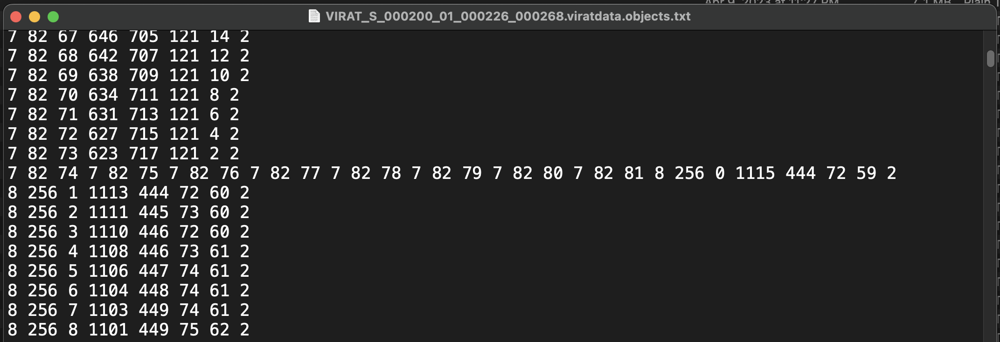

After:

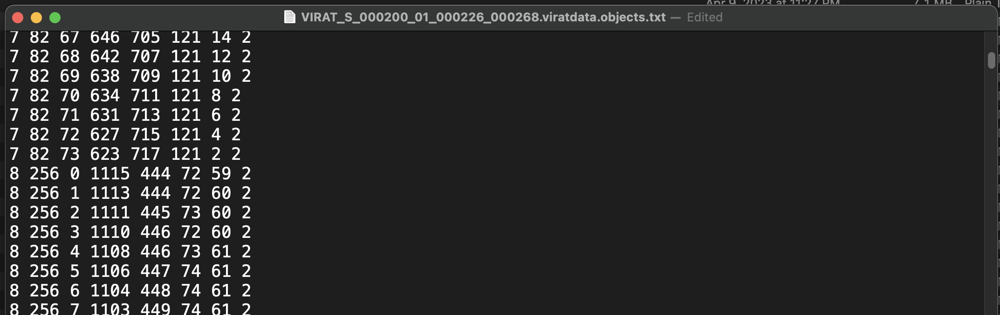

The following were modified in similar fashion to the above:

['/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_000200_01_000226_000268.viratdata.objects.txt',
 '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_000206_09_001714_001851.viratdata.objects.txt',
 '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_050201_07_001348_001458.viratdata.objects.txt',
 '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_050203_07_001288_001531.viratdata.objects.txt',
 '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_050203_09_001960_002083.viratdata.objects.txt']

#### Summary

- 329 total videos
- 14 videos don't have corresponding objects.txt file
- 5 + 1 objects.txt files are corrupted in some way that requires cleaning (1 already cleaned)
- 5 object.txt files with "Object_Type" == 0 objects. These which appear to be mistakes. Or, Possibly used for Events? Need to look into this.

#### Grabbing all People
For every Person in video, write .jpg files with bounding boxes drawn on them.

This will be used to manual clean the data.

In [103]:
object_columns = ['Object_ID', 'Duration', 'Current_Frame', 'bbox_lefttop_x',
                  'bbox_lefttop_y', 'bbox_width', 'bbox_height', 'Object_Type']

In [104]:
# Write .jpg images with bounding boxes for each person in video

def get_images_of_objects(video_path, object_path, color=(0, 255, 0), thickness=2):
    '''takes video path and object path,
    writes .jpg files for each person (Object_Type=1) in video
    with bounding box.
    Uses first frame which the person appears in'''
    
    # create parent folder for images
    loc = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/people_images/'
    folder = loc + video_path.split('.')[0]
    if not os.path.exists(folder):
        os.mkdir(folder)
    if object_path == None:
        return
    
    # get df
    loc = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/'
    full_object_path = loc + object_path
    df = pd.read_csv(full_object_path, sep=" ", names=object_columns, index_col=False)
    
    # get Object_IDs for all people
    obj_type = 1 # <-- change the object type if you want to see other objects (not people)
    people_ids = df[df['Object_Type'] == obj_type]['Object_ID'].unique()
    
    # loop through all people
    ppl_count = 0
    for obj_id in people_ids:
        ppl_count +=1
        # get index of first frame of object
        idx = pd.DataFrame(df[df['Object_ID'] == obj_id].iloc[0]).T.index.values[0]

        # Get Bounding Box coordinates
        x_min = df['bbox_lefttop_x'][idx]
        y_min = df['bbox_lefttop_y'][idx]
        x_max = df['bbox_lefttop_x'][idx] + df['bbox_width'][idx]
        y_max = df['bbox_lefttop_y'][idx] + df['bbox_height'][idx]

        # load video
        loc = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/'
        full_video_path = loc + video_path
        cap = cv2.VideoCapture(full_video_path)
        
        # set frame position
        frame_index = df.iloc[idx]['Current_Frame']
        cap.set(cv2.CAP_PROP_POS_FRAMES, frame_index)
        
        # read frame
        success, frame = cap.read()
        if not success:
            print("Failed to read the frame")
            return
        if success:
            # draw bounding box on the frame
            cv2.rectangle(frame, (x_min, y_min), (x_max, y_max), color, thickness)
            
            # write frame to .jpg and store in parent folder
            filepath = folder + '/' + str(obj_id) + '.jpg'
            cv2.imwrite(filepath, frame)
        
        # end capture
        cap.release()
    print(video_path, ' has:\t', ppl_count, 'people')

In [105]:
# change i to get different videos
i = 0

video_path, object_path = all_keys[key_list[i]]
print(video_path)
print(object_path)

VIRAT_S_000001.mp4
VIRAT_S_000001.viratdata.objects.txt


Get images of people from first video

In [108]:
get_images_of_objects(video_path, object_path)

VIRAT_S_000001.mp4  has:	 11 people


### Examine Videos

#### Q: Are all people captured by the labels?
#### A: No

Observe video 'VIRAT_S_000201_01_000384_000589.mp4' has only 2 people annotated, but more are present (I personally counted 16 when watching the video):

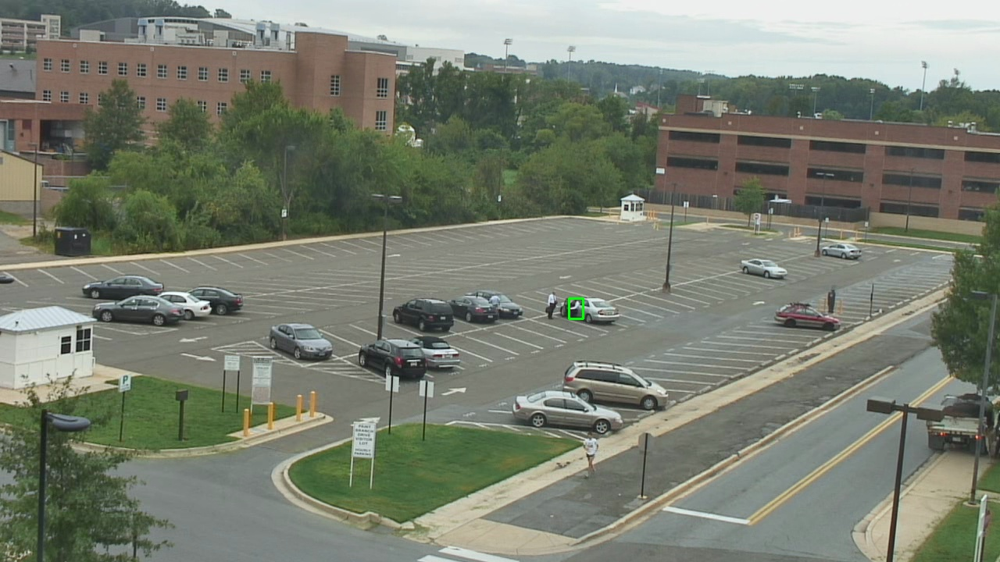

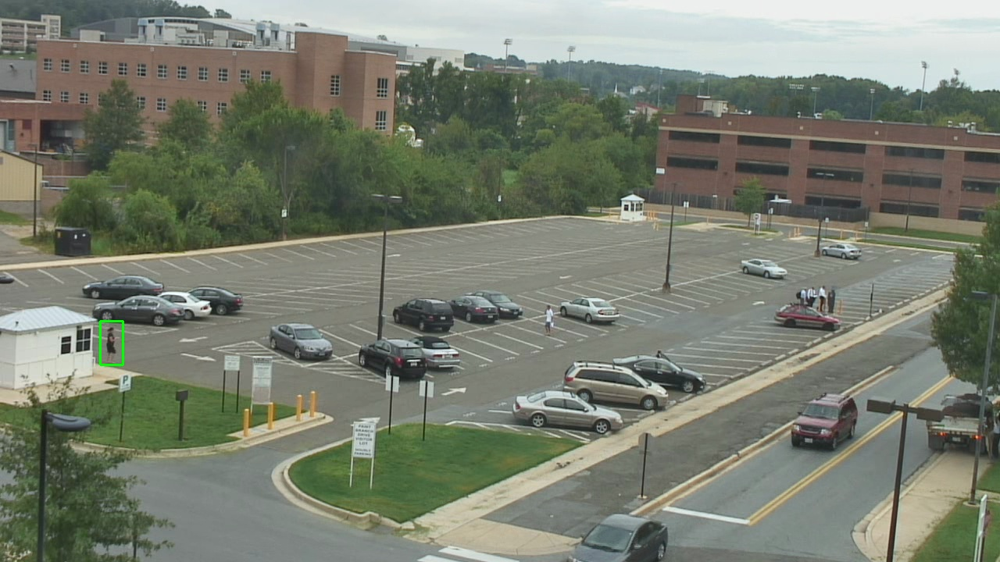

Looking at video, counted 16 people

Looking at `/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/annotations/VIRAT_S_000201_01_000384_000589.viratdata.objects.txt`, observed only 4 objects total are annotated (2 people, 2 cars). .txt file is missing object_id 2... which leads me to believe this is corrupted data.

### The above (section 3) should be summarized into main points of unusability. No need for the whole expository drama.
- Object annotation files were corrupted and needed cleaning
- After cleaning discovered that not all people are accounted for, probably due to issues during labeling process (possibly human error in Mechanical Turk or other)
- These annotation files were not usable due to this.

## 4. IARPA DIVA Annotations

4. IARPA DIVA Annotations
- 4.1 -- DIVA Annotation Files EDA
- 4.2 -- Data Formats
    - .types.yml
    - .geom.yml
    - .regions.yml
    - .activities.yml
- 4.3 -- Object Detection Verification
- 4.4 -- Object Track Verification
- 4.5 -- Event Detection Verification
- 4.6 -- Metrics

Compare against DIVA annotations? are they any better?
- Can do quick look first

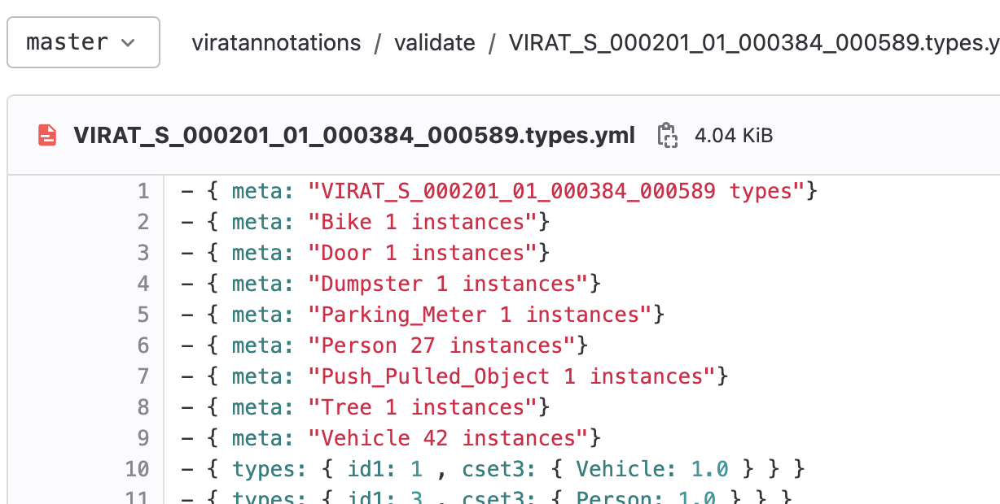

The IARPA DIVA annotations do seem to have more information. 

Documentation for them here: https://kwiver-diva.readthedocs.io/en/latest/introduction.html

### Explore some data from VIRAT_S_000001.geom.yml

In [112]:
%%time
file_path = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/diva_annotations/train/VIRAT_S_000001.geom.yml'
with open(file_path, 'r') as file:
    data = yaml.safe_load(file)

CPU times: user 46.6 s, sys: 413 ms, total: 47 s
Wall time: 47 s


In [113]:
len(data)

179577

{ geom: { id1: 1, id0: 0, ts0: 3455, ts1: 115.166666666667, g0: 1 663 77 795 , src: truth, } }

In [114]:
data[4]['geom']['src']

'truth'

In [115]:
7294 + 28872

36166

In [116]:
# count src: 'truth'
count = 0
for i in range(4, len(data)):
    try:
        if data[i]['geom']['src'] == 'truth':
            count += 1
    except:
        pass
count

179573

In [117]:
# count occlusion: 'partially'
count = 0
for i in range(4, len(data)):
    try: 
        if data[i]['geom']['occlusion'] == 'partially':
            count += 1
    except:
        count = count
print(count)

28872


In [118]:
# sum ( occlusion: 'partially', occlusion: 'mostly')
28872 + 7294

36166

In [119]:
# un-occluded object-frames
179573 - 36166

143407

In [120]:
data[4]['geom']['g0'].split(' ')

['1', '663', '77', '795']

In [121]:
my_list = data[4]['geom']['g0'].split(' ')
x_min, x_max = int(my_list[0]), int(my_list[1])
y_min, y_max = int(my_list[2]), int(my_list[3])

In [122]:
c_frame = data[4]['geom']['ts0']

### Show object 1 in image

In [123]:
# Show first object of first video

# load video
video_path = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/VIRAT_S_000001.mp4'
cap = cv2.VideoCapture(video_path)

# set frame position
cap.set(cv2.CAP_PROP_POS_FRAMES, c_frame)

# read frame
success, frame = cap.read()
if not success:
    print("Failed to read the frame")
if success:
    # draw bounding box on the frame
    cv2.rectangle(frame, (x_min, x_max), (y_min, y_max), (0,255,0), 2)

    # write frame to .jpg and store in parent folder
    cv2.imshow(f"Frame {c_frame}", frame)
    cv2.waitKey(5000)
    
# end capture
cap.release()
cv2.destroyAllWindows()
cv2.waitKey(1)
cv2.waitKey(1)
cv2.waitKey(1)
cv2.waitKey(1);

Video: VIRAT_S_000001.mp4

File: VIRAT_S_000001.geom.yml

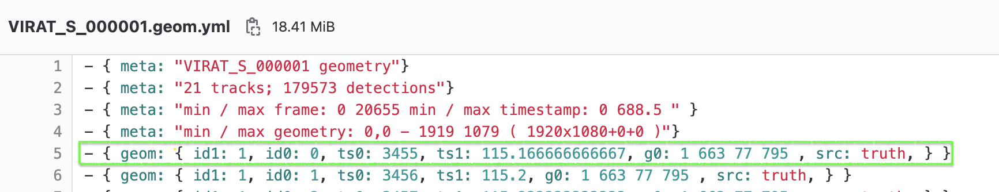

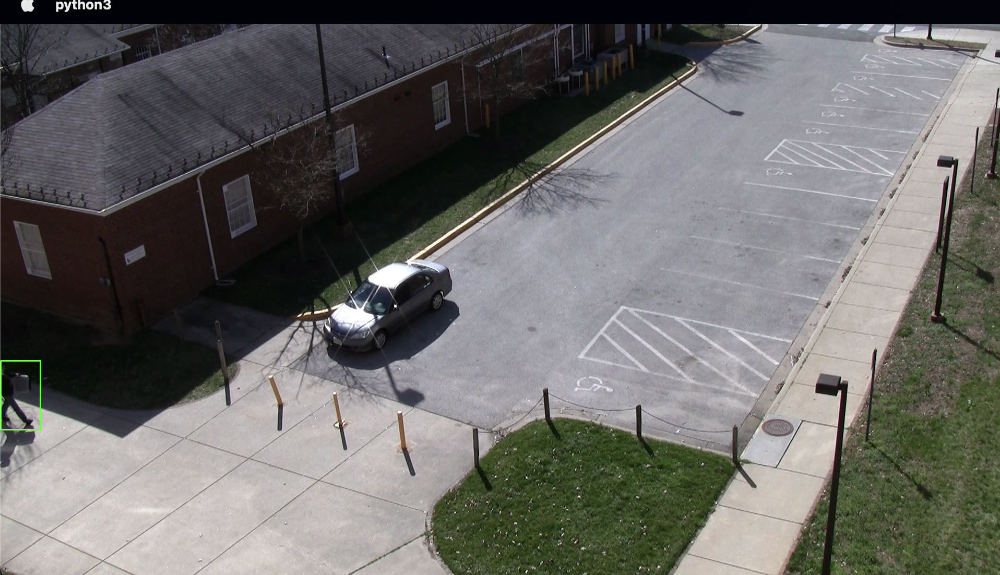

### Show Object 1 with bounding box in video

In [124]:
def get_track_data(video_path, geom_data, id1):
    track = []
    for i in geom_data:
        try:
            if (i['geom']['id1'] == id1):
                track.append(i)
        except:
            pass
    return track

In [125]:
def end_sequence(cap):
    cap.release() # Release video capture
    cv2.destroyAllWindows() # close windows
    cv2.waitKey(1)
    cv2.waitKey(1)
    cv2.waitKey(1)
    cv2.waitKey(1); # mac needs 4 loops of .waitKey(1) to to destroy windows..

In [126]:
def show_object_in_video(video_path, geom_data, id1, color=(0,255,0), thickness=2):
    
    # get track data
    track = get_track_data(video_path, geom_data, id1)
        
    # load video
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print("Error opening video file")
    
    # if there's no data, quit
    try:
        frame_number = track[0]['geom']['ts0']
    except:
        print('id1: ', id1, ' does not have any frame data')
        return
    
    count = 0
    cap.set(cv2.CAP_PROP_POS_FRAMES, frame_number) # set the frame position
    # loop through the frames
    while cap.isOpened():
        ret, frame = cap.read()
        #print('got2')
        if not ret:
            print("Error reading frame")
            break
    
        # If the current frame is in the track frames (ts0), draw the bounding box and display it
        if (frame_number in [i['geom']['ts0'] for i in track]):
            #print('got3')
            x_min, y_min, x_max, y_max = [int(j) for j in track[count]['geom']['g0'].split(' ')]
            
            cv2.rectangle(frame, (x_min,y_min), (x_max,y_max), color, thickness)
            cv2.imshow(f'id1:{id1}', frame)
        
        # End playback if not in track
        if (frame_number not in [i['geom']['ts0'] for i in track]):
            end_sequence(cap)
            break
        
        # Break the loop if 'q' key is pressed
        if cv2.waitKey(25) & 0xFF == ord('q'):
            end_sequence(cap)
            break
        
        frame_number += 1
        count += 1
        print(frame_number)     

In [127]:
file_path = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/diva_annotations/train/\
VIRAT_S_000001.geom.yml'
with open(file_path, 'r') as file:
    data_VIRAT_S_000001 = yaml.safe_load(file)

In [130]:
id1 = 1
video_path = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/VIRAT_S_000001.mp4'

show_object_in_video(video_path, data_VIRAT_S_000001, id1)

3456
3457
3458
3459
3460
3461
3462
3463
3464
3465
3466
3467
3468
3469
3470
3471
3472
3473
3474
3475
3476
3477
3478
3479
3480
3481
3482
3483
3484
3485
3486
3487
3488
3489
3490
3491
3492
3493
3494
3495
3496
3497
3498
3499
3500
3501
3502
3503
3504
3505
3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516
3517
3518
3519
3520
3521
3522
3523
3524
3525
3526
3527
3528
3529
3530
3531
3532
3533
3534
3535
3536
3537
3538
3539
3540
3541
3542
3543
3544
3545
3546
3547
3548
3549
3550
3551
3552
3553
3554
3555
3556
3557
3558
3559
3560
3561
3562
3563
3564
3565
3566
3567
3568
3569
3570
3571
3572
3573
3574
3575
3576
3577
3578
3579
3580
3581
3582
3583
3584
3585
3586
3587
3588
3589
3590
3591
3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655


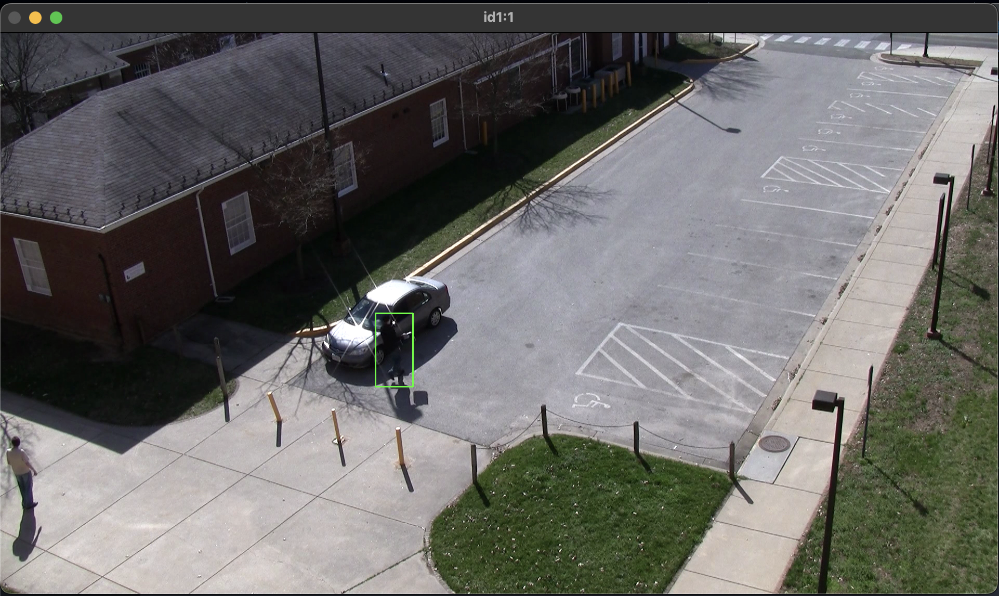

### Check a few others

In [131]:
# get all video paths for the DIVA annotations
all_video_paths = os.listdir('/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original')
all_video_paths.sort()
print(len(all_video_paths))
print(all_video_paths[:10])

329
['VIRAT_S_000001.mp4', 'VIRAT_S_000002.mp4', 'VIRAT_S_000003.mp4', 'VIRAT_S_000004.mp4', 'VIRAT_S_000006.mp4', 'VIRAT_S_000101.mp4', 'VIRAT_S_000102.mp4', 'VIRAT_S_000200_00_000100_000171.mp4', 'VIRAT_S_000200_01_000226_000268.mp4', 'VIRAT_S_000200_02_000479_000635.mp4']


In [132]:
# get all annotation .object.txt paths
# from /annotations folder
geom_paths = []
obj_p = os.listdir('/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/diva_annotations/train')
for string in obj_p:
    if string[-8:] == 'geom.yml':
        geom_paths.append(string)
geom_paths.sort()
print(len(geom_paths))
print(geom_paths[:10])

64
['VIRAT_S_000000.geom.yml', 'VIRAT_S_000001.geom.yml', 'VIRAT_S_000002.geom.yml', 'VIRAT_S_000005.geom.yml', 'VIRAT_S_000200_03_000657_000899.geom.yml', 'VIRAT_S_000200_05_001525_001575.geom.yml', 'VIRAT_S_000201_03_000640_000672.geom.yml', 'VIRAT_S_000201_05_001081_001215.geom.yml', 'VIRAT_S_000201_06_001354_001397.geom.yml', 'VIRAT_S_000201_07_001485_001581.geom.yml']


In [133]:
# Map identifier strings (keys) to video and object filepaths

diva_keys = {}
# first 7 videos have shorter identifier sequences
for i in range(7):
    key = all_video_paths[i][:14]
    keyed_video = all_video_paths[i]
    keyed_object = None
    for j in range(0, len(geom_paths)):
        if geom_paths[j][:14] == key:
            keyed_object = geom_paths[j]
    diva_keys[key] = [keyed_video, keyed_object]

# rest are longer
for i in range(7, len(all_video_paths)):
    key = all_video_paths[i][:23]
    keyed_video = all_video_paths[i]
    keyed_object = None
    for j in range(0, len(geom_paths)):
        if geom_paths[j][:23] == key:
            keyed_object = geom_paths[j]
    diva_keys[key] = [keyed_video, keyed_object]

In [134]:
# for usage, make a list of the keys
diva_list = []
for key in diva_keys.keys():
    diva_list.append(key)

In [135]:
train_geoms = []
for i in range(len(diva_keys)):
    if diva_keys[diva_list[i]][1] != None:
        train_geoms.append(diva_list[i])

### Check a few others

In [136]:
idx = 20 # change this. Get different video / annotation combos.

geom_prefix = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/diva_annotations/train/'
geom_path = geom_prefix + diva_keys[train_geoms[idx]][1]
print(geom_path)

vid_prefix = '/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/'
video_path = vid_prefix + diva_keys[train_geoms[idx]][0]
print(video_path)

/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/diva_annotations/train/VIRAT_S_040000_05_000668_000703.geom.yml
/Users/p/Documents/Code/VIRAT/VIRAT Ground Dataset/videos_original/VIRAT_S_040000_05_000668_000703.mp4


In [137]:
%%time
import yaml
with open(geom_path, 'r') as file:
    data = yaml.safe_load(file)

CPU times: user 2.57 s, sys: 19.6 ms, total: 2.59 s
Wall time: 2.59 s


In [138]:
id1 = 1 # change this. Observe id1 types in .types.yml file.

show_object_in_video(video_path, data, id1)

306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
321
322
323
324
325
326
327
328
329
330
331
332
333
334
335
336
337
338
339
340
341
342
343
344
345
346
347
348
349
350
351
352
353
354
355
356
357
358
359
360
361
362
363
364
365
366
367
368
369
370
371
372
373
374
375
376
377
378
379
380
381
382
383
384
385
386
387
388
389
390
391
392
393
394
395
396
397
398
399
400
401
402
403
404
405
406
407
408
409
410
411
412
413
414
415
416
417
418
419
420
421
422
423
424
425
426
427
428
429
430
431
432
433
434
435
436
437
438
439
440
441
442
443
444
445
446
447
448
449
450
451
452
453
454
455
456
457
458
459
460
461
462
463
464
465
466
467
468
469
470
471
472
473
474
475
476
477
478
479
480
481
482
483
484
485
486
487
488
489
490
491
492
493
494
495
496
497
498
499
500
501
502
503
504
505
506
507
508
509
510
511
512
513
514
515
516
517
518
519
520
521
522
523
524
525
526
527
528
529
530
531
532
533
534
535
536
537
538
539
540
541
542
543
544
545
546
547
548
549
550
551
552
553
554
555


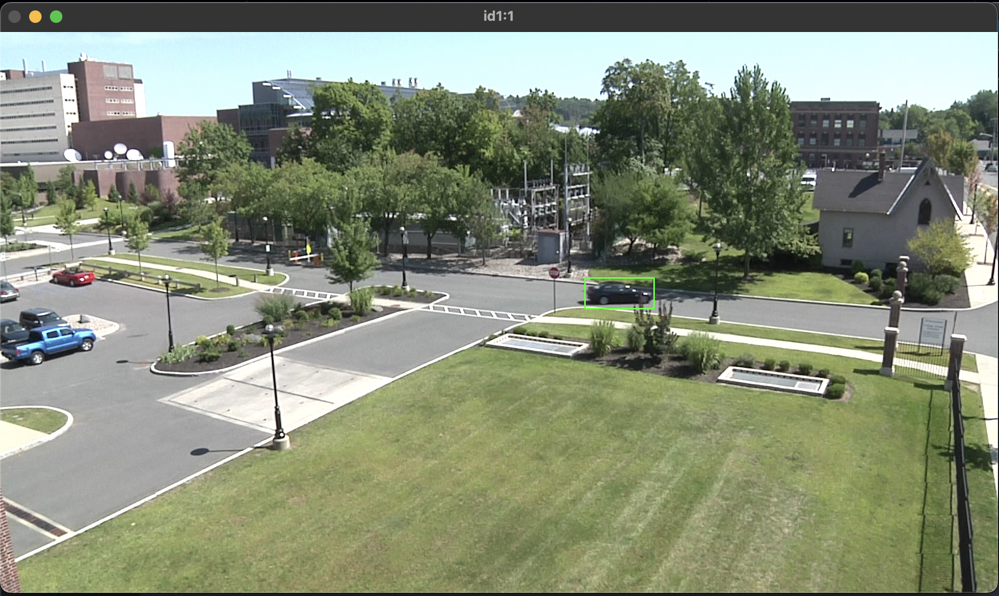